In [2]:
train_folder = '/Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/fin-detection/train'
annotated_folder = '/Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/fin-detection/annotated'
non_annotated_folder = '/Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/fin-detection/non_annotated'
cr2_folder = '/Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/fin-detection/cr2'
converted_folder = '/Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/fin-detection/converted'
cropped_folder = '/Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/fin-detection/cropped'

yolo_train_folder = '/Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/train'
yolo_val_folder = '/Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val'

In [4]:
import json
import glob
import shutil
import random
import os
from PIL import Image
import matplotlib.pyplot as plt

# Data preparation
Images are labeled by json files with 4 points. Need to convert annotations to YOLO model inputs - txt files in format:

`<class_id> <x_center> <y_center> <width> <height>`

Also split images to train and validation sets (80/20) and create specific folder structure then described in yaml file.



In [14]:
json_files = glob.glob(annotated_folder + '/*.json')
val_size = 0.2

for json_file in json_files:
    
    if random.random() < val_size:
        target_folder = yolo_val_folder
    else:
        target_folder = yolo_train_folder

    image_path = os.path.join(os.path.dirname(json_file), os.path.basename(json_file).replace('.json', '.JPG'))
    target_img_path = os.path.join(target_folder + '/images', os.path.basename(json_file).replace('.json', '.JPG'))
    target_txt_path = os.path.join(target_folder + '/labels', os.path.basename(json_file).replace('.json', '.txt'))
    # Load the JSON data from the file
    with open(json_file, 'r') as file:
        annotations = json.load(file)
        image = Image.open(image_path)

        # Extract the list of shapes
        shapes = annotations.get('shapes', [])

        img_width, img_height = image.size

        # Iterate over each shape and print the coordinates of points
        for index, shape in enumerate(shapes):
            points = shape.get('points', [])
            xs = [point[0] for point in points]
            ys = [point[1] for point in points]

            bbox = (min(xs), min(ys), max(xs), max(ys))

            bbox_width = bbox[2] - bbox[0]
            bbox_height = bbox[3] - bbox[1]

            bbox_center_x = bbox[0] + bbox_width / 2
            bbox_center_y = bbox[1] + bbox_height / 2

            # Normalize the bounding box coordinates
            bbox_center_x /= img_width
            bbox_center_y /= img_height
            bbox_width /= img_width
            bbox_height /= img_height

            # Save the bounding box coordinates to the text file
            with open(target_txt_path, 'a') as file:
                file.write(f"0 {bbox_center_x} {bbox_center_y} {bbox_width} {bbox_height}\n")

        # Copy the image to the target folder
        shutil.copy(image_path, target_img_path)

In [ ]:
val_images_folder = os.path.join(yolo_val_folder, 'images')
val_labels_folder = os.path.join(yolo_val_folder, 'labels')

# Get the list of image files in the validation folder
val_image_files = os.listdir(val_images_folder)

# Iterate over each image file
for image_file in val_image_files:
    # Load the image
    image_path = os.path.join(val_images_folder, image_file)
    image = plt.imread(image_path)

    plt.imshow(image)

    # Get the corresponding label file
    label_file = image_file.replace('.JPG', '.txt')
    label_path = os.path.join(val_labels_folder, label_file)

    # Read the bounding box coordinates from the label file
    with open(label_path, 'r') as file:
        lines = file.readlines()
        bboxes = [line.strip().split(' ') for line in lines]

    # Plot the image
    plt.imshow(image)
    
    # Plot each bounding box
    for bbox in bboxes:
        # Assuming the format is: class x_center y_center width height
        _, x_center, y_center, width, height = map(float, bbox)
        
        # Convert from YOLO format to matplotlib format
        x_min = (x_center - width / 2) * image.shape[1]
        y_min = (y_center - height / 2) * image.shape[0]
        x_max = (x_center + width / 2) * image.shape[1]
        y_max = (y_center + height / 2) * image.shape[0]
        
        # Create a rectangle patch
        rect = plt.Rectangle((x_min, y_min), x_max - x_min, y_max - y_min, edgecolor='r', linewidth=2, fill=False)
        plt.gca().add_patch(rect)
    
    # Show the plot
    plt.show()


In [9]:
from ultralytics import YOLO

# Load a model
model = YOLO("yolo11n.pt")

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/Users/dimonster/Library/Application Support/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 5.35M/5.35M [00:00<00:00, 8.72MB/s]


In [14]:
yaml_file = '/Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/fins.yaml'
results = model.train(data=yaml_file, epochs=100, imgsz=640, device="mps")

New https://pypi.org/project/ultralytics/8.3.35 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.34 🚀 Python-3.12.7 torch-2.5.1 MPS (Apple M3)
engine/trainer: task=detect, mode=train, model=yolo11n.pt, data=/Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/fins.yaml, epochs=100, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=mps, workers=8, project=None, name=train5, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=N

train: Scanning /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/train/labels.cache... 240 images, 0 backgrounds, 0 corrupt: 100%|██████████|
val: Scanning /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/labels.cache... 57 images, 0 backgrounds, 0 corrupt: 100%|██████████| 57/5

Plotting labels to runs/detect/train5/labels.jpg... 


optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0005), 87 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to runs/detect/train5
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      8.57G     0.9495     0.5668     0.9961         53        640: 100%|██████████| 15/15 [00:50<00:00,  3.38s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:16<00:16, 16.42s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:25<00:00, 12.73s/it]


                   all         57         84      0.926      0.643      0.659      0.375

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      8.63G     0.9914     0.5541      1.031         48        640: 100%|██████████| 15/15 [00:39<00:00,  2.63s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:09<00:09,  9.05s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:16<00:00,  8.22s/it]


                   all         57         84       0.98      0.655      0.679      0.422

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      7.58G      1.024     0.5768      1.048         46        640: 100%|██████████| 15/15 [00:29<00:00,  1.99s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:09<00:09,  9.84s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:17<00:00,  8.60s/it]


                   all         57         84      0.966      0.679      0.733      0.438

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      7.63G       1.13      0.617      1.105         30        640: 100%|██████████| 15/15 [00:35<00:00,  2.37s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:09<00:09,  9.45s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:16<00:00,  8.24s/it]


                   all         57         84          1      0.651      0.707      0.416

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      7.69G      1.117     0.6276      1.116         41        640: 100%|██████████| 15/15 [00:28<00:00,  1.91s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:09<00:09,  9.65s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:16<00:00,  8.45s/it]


                   all         57         84          1      0.606      0.625      0.372

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      7.74G      1.122     0.6282      1.094         32        640: 100%|██████████| 15/15 [00:28<00:00,  1.90s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:15<00:15, 15.56s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:23<00:00, 11.79s/it]


                   all         57         84      0.936      0.179      0.206      0.106

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      7.78G      1.107     0.6325       1.09         41        640: 100%|██████████| 15/15 [00:27<00:00,  1.83s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:14<00:14, 14.25s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:21<00:00, 10.74s/it]


                   all         57         84      0.899      0.321      0.352      0.169

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      7.81G      1.162     0.6419      1.112         49        640: 100%|██████████| 15/15 [00:29<00:00,  1.98s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:10<00:10, 10.06s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:17<00:00,  8.69s/it]


                   all         57         84      0.968      0.607      0.692      0.347

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      7.83G      1.173     0.6791       1.14         33        640: 100%|██████████| 15/15 [00:27<00:00,  1.86s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:10<00:10, 10.66s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:17<00:00,  8.95s/it]


                   all         57         84      0.855       0.31      0.356      0.211

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      7.85G      1.207     0.6746      1.144         32        640: 100%|██████████| 15/15 [00:29<00:00,  1.94s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:09<00:09,  9.75s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:16<00:00,  8.47s/it]


                   all         57         84      0.908      0.667      0.683      0.366

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      7.92G      1.152     0.6715      1.108         37        640: 100%|██████████| 15/15 [00:27<00:00,  1.87s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:12<00:12, 12.92s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:20<00:00, 10.08s/it]


                   all         57         84      0.886      0.557      0.592      0.306

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      7.95G      1.164     0.6618      1.112         37        640: 100%|██████████| 15/15 [00:28<00:00,  1.88s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:10<00:10, 10.26s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:20<00:00, 10.05s/it]


                   all         57         84      0.958     0.0238     0.0353     0.0232

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      7.96G      1.137     0.6321      1.125         45        640: 100%|██████████| 15/15 [00:28<00:00,  1.88s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:12<00:12, 12.73s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:19<00:00,  9.84s/it]


                   all         57         84      0.921      0.692      0.739      0.424

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      8.01G      1.137     0.6282      1.115         43        640: 100%|██████████| 15/15 [00:27<00:00,  1.81s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:13<00:13, 13.27s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:20<00:00, 10.24s/it]


                   all         57         84      0.963      0.627      0.671      0.382

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      8.04G      1.144     0.6395      1.101         45        640: 100%|██████████| 15/15 [00:27<00:00,  1.85s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:13<00:13, 13.81s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:20<00:00, 10.45s/it]


                   all         57         84      0.858      0.321      0.351      0.171

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      8.08G      1.097      0.626      1.096         39        640: 100%|██████████| 15/15 [00:27<00:00,  1.85s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:25<00:25, 25.40s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:48<00:00, 24.37s/it]


                   all         57         84      0.863       0.19      0.213      0.109

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      8.13G      1.143     0.6567      1.109         36        640: 100%|██████████| 15/15 [00:29<00:00,  1.94s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:17<00:17, 17.94s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:33<00:00, 16.85s/it]


                   all         57         84      0.979     0.0952      0.108     0.0617

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      8.13G      1.117     0.6438      1.106         34        640: 100%|██████████| 15/15 [00:28<00:00,  1.89s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:16<00:16, 16.63s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:23<00:00, 11.95s/it]


                   all         57         84       0.98      0.536      0.593       0.34

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      8.16G      1.164     0.6525      1.115         52        640: 100%|██████████| 15/15 [00:27<00:00,  1.84s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:10<00:10, 10.35s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:23<00:00, 11.83s/it]


                   all         57         84      0.941      0.571      0.599      0.323

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      8.18G      1.151     0.6427      1.112         50        640: 100%|██████████| 15/15 [00:28<00:00,  1.90s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:13<00:13, 13.60s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:24<00:00, 12.21s/it]


                   all         57         84      0.755       0.31      0.317       0.18

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100       8.2G      1.135     0.6254      1.104         32        640: 100%|██████████| 15/15 [00:28<00:00,  1.91s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:10<00:10, 10.38s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:17<00:00,  8.83s/it]


                   all         57         84      0.898      0.631      0.651      0.376

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      8.22G      1.126       0.62      1.113         39        640: 100%|██████████| 15/15 [00:27<00:00,  1.83s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:09<00:09,  9.52s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:16<00:00,  8.25s/it]


                   all         57         84      0.924      0.581      0.608      0.357

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      8.24G       1.07     0.5844      1.071         52        640: 100%|██████████| 15/15 [00:27<00:00,  1.83s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:09<00:09,  9.57s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:16<00:00,  8.29s/it]


                   all         57         84      0.986      0.667      0.714      0.397

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      8.26G      1.115     0.6086      1.087         50        640: 100%|██████████| 15/15 [00:33<00:00,  2.26s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:09<00:09,  9.69s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:16<00:00,  8.27s/it]


                   all         57         84      0.978      0.643      0.665      0.387

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      8.29G      1.073     0.6074      1.069         35        640: 100%|██████████| 15/15 [00:26<00:00,  1.79s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:10<00:10, 10.32s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:20<00:00, 10.29s/it]


                   all         57         84      0.989      0.321      0.356      0.194

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      8.34G      1.104     0.6125      1.098         40        640: 100%|██████████| 15/15 [00:28<00:00,  1.90s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:12<00:12, 12.46s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:19<00:00,  9.91s/it]


                   all         57         84      0.812      0.381      0.401      0.226

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      8.34G      1.078     0.5964      1.089         32        640: 100%|██████████| 15/15 [00:42<00:00,  2.85s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:09<00:09,  9.94s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:17<00:00,  8.85s/it]


                   all         57         84      0.872      0.648      0.689      0.391

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      8.37G      1.064     0.5848      1.083         31        640: 100%|██████████| 15/15 [00:27<00:00,  1.83s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:09<00:09,  9.98s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:18<00:00,  9.00s/it]


                   all         57         84      0.879      0.381      0.459      0.273

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      8.39G      1.035     0.5673       1.07         44        640: 100%|██████████| 15/15 [00:34<00:00,  2.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:09<00:09,  9.57s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:16<00:00,  8.28s/it]


                   all         57         84      0.962       0.69      0.734      0.417

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      8.41G      1.046     0.6027      1.055         41        640: 100%|██████████| 15/15 [00:28<00:00,  1.88s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:10<00:10, 10.18s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:17<00:00,  9.00s/it]


                   all         57         84      0.962      0.605      0.642      0.386

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      8.44G      1.065     0.5931      1.072         43        640: 100%|██████████| 15/15 [00:28<00:00,  1.92s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:09<00:09,  9.46s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:17<00:00,  8.61s/it]


                   all         57         84      0.982      0.652       0.69      0.412

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      8.49G       1.04     0.5734      1.078         42        640: 100%|██████████| 15/15 [00:29<00:00,  1.96s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:10<00:10, 10.20s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:17<00:00,  8.94s/it]


                   all         57         84      0.976      0.714       0.75      0.419

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      8.58G      1.033     0.5801      1.063         48        640: 100%|██████████| 15/15 [00:28<00:00,  1.90s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:09<00:09,  9.43s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:16<00:00,  8.24s/it]


                   all         57         84      0.954      0.619      0.686      0.382

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      8.58G      1.023     0.5876      1.054         44        640: 100%|██████████| 15/15 [00:35<00:00,  2.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:14<00:14, 14.71s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:22<00:00, 11.13s/it]


                   all         57         84      0.937      0.226      0.249      0.156

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      8.64G     0.9871     0.5456      1.014         34        640: 100%|██████████| 15/15 [00:28<00:00,  1.89s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:09<00:09,  9.62s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:16<00:00,  8.42s/it]


                   all         57         84      0.963      0.595      0.649      0.371

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      8.66G      1.049     0.5565      1.065         35        640: 100%|██████████| 15/15 [00:27<00:00,  1.84s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:16<00:00,  8.17s/it]


                   all         57         84      0.957       0.81      0.831      0.477

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      8.66G     0.9686     0.5693      1.038         44        640: 100%|██████████| 15/15 [00:36<00:00,  2.41s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:10<00:10, 10.73s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:18<00:00,  9.22s/it]


                   all         57         84      0.984      0.736      0.787      0.444

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      8.69G      1.044     0.5699      1.068         30        640: 100%|██████████| 15/15 [00:35<00:00,  2.40s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:09<00:09,  9.74s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:22<00:00, 11.36s/it]


                   all         57         84      0.973       0.56      0.599      0.352

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      8.75G     0.9929     0.5502      1.059         40        640: 100%|██████████| 15/15 [00:28<00:00,  1.88s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:09<00:09,  9.99s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:17<00:00,  8.55s/it]


                   all         57         84      0.914      0.643      0.659       0.38

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      8.77G     0.9853     0.5434      1.042         48        640: 100%|██████████| 15/15 [00:29<00:00,  1.96s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:16<00:00,  8.14s/it]


                   all         57         84      0.966      0.677      0.737      0.428

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100       8.8G      1.008     0.5701      1.044         59        640: 100%|██████████| 15/15 [00:28<00:00,  1.91s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:09<00:09,  9.81s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:17<00:00,  8.51s/it]


                   all         57         84      0.881      0.643      0.682      0.384

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      8.84G      1.002     0.5552      1.045         28        640: 100%|██████████| 15/15 [00:29<00:00,  1.97s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:09<00:09,  9.77s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:17<00:00,  8.53s/it]


                   all         57         84      0.933      0.679      0.724      0.412

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      8.89G       1.04     0.5512      1.058         26        640: 100%|██████████| 15/15 [00:29<00:00,  1.99s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:09<00:09,  9.58s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:18<00:00,  9.13s/it]


                   all         57         84       0.93      0.796      0.825      0.476

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      8.91G     0.9586     0.5209      1.047         29        640: 100%|██████████| 15/15 [00:26<00:00,  1.79s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:10<00:10, 10.22s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:17<00:00,  8.62s/it]


                   all         57         84       0.96      0.619       0.66        0.4

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      8.94G      1.022     0.5453      1.058         45        640: 100%|██████████| 15/15 [00:35<00:00,  2.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:09<00:09,  9.54s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:16<00:00,  8.35s/it]


                   all         57         84      0.929      0.643      0.673      0.394

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100         9G     0.9562     0.5383      1.024         47        640: 100%|██████████| 15/15 [00:27<00:00,  1.81s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:09<00:09,  9.83s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:17<00:00,  8.63s/it]


                   all         57         84      0.963      0.667      0.691      0.416

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      9.04G     0.9631     0.5348       1.03         37        640: 100%|██████████| 15/15 [00:29<00:00,  1.96s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:09<00:09,  9.96s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:16<00:00,  8.42s/it]


                   all         57         84      0.968      0.726      0.744      0.429

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      9.09G     0.9874     0.5628      1.037         48        640: 100%|██████████| 15/15 [00:26<00:00,  1.77s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:13<00:13, 13.20s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:22<00:00, 11.44s/it]


                   all         57         84      0.989      0.583      0.611      0.339

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100       9.1G     0.9925     0.5527      1.035         51        640: 100%|██████████| 15/15 [00:27<00:00,  1.84s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:12<00:12, 12.85s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:19<00:00,  9.99s/it]


                   all         57         84      0.978      0.607      0.633      0.375

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      9.16G     0.9789     0.5375      1.038         33        640: 100%|██████████| 15/15 [00:28<00:00,  1.90s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:09<00:09,  9.99s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:16<00:00,  8.44s/it]


                   all         57         84      0.978      0.679      0.698      0.395

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      9.18G      0.949     0.5159      1.037         36        640: 100%|██████████| 15/15 [00:27<00:00,  1.83s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:09<00:09,  9.67s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:16<00:00,  8.48s/it]


                   all         57         84          1      0.619      0.642      0.358

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      9.18G     0.9342     0.5195      1.018         50        640: 100%|██████████| 15/15 [00:27<00:00,  1.83s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:16<00:00,  8.39s/it]


                   all         57         84       0.98       0.69      0.722      0.417

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      9.22G     0.9376     0.5133      1.002         44        640: 100%|██████████| 15/15 [00:26<00:00,  1.79s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:17<00:00,  8.61s/it]


                   all         57         84      0.983      0.689      0.725      0.436

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100      10.3G     0.9323     0.5316     0.9976         36        640: 100%|██████████| 15/15 [00:34<00:00,  2.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:17<00:00,  8.91s/it]


                   all         57         84      0.994      0.714      0.766      0.461

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      9.31G      0.936     0.5429      1.028         37        640: 100%|██████████| 15/15 [00:27<00:00,  1.81s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:11<00:11, 11.10s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:18<00:00,  9.10s/it]


                   all         57         84      0.993      0.476       0.52      0.312

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      9.33G     0.8997     0.5055      1.007         40        640: 100%|██████████| 15/15 [00:41<00:00,  2.80s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:09<00:09,  9.77s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:16<00:00,  8.32s/it]


                   all         57         84      0.983      0.688      0.719       0.42

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      9.35G     0.8914     0.4936      1.012         38        640: 100%|██████████| 15/15 [00:27<00:00,  1.85s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:10<00:10, 10.11s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:17<00:00,  8.84s/it]


                   all         57         84      0.996      0.643      0.696      0.417

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100      9.36G     0.8901     0.4994     0.9805         32        640: 100%|██████████| 15/15 [00:28<00:00,  1.91s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:09<00:09,  9.77s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:16<00:00,  8.30s/it]


                   all         57         84      0.938      0.619      0.664      0.385

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      9.39G     0.9311     0.5054       1.01         43        640: 100%|██████████| 15/15 [00:41<00:00,  2.80s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:09<00:09,  9.89s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:17<00:00,  8.78s/it]


                   all         57         84      0.987      0.655       0.73       0.42

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      9.45G     0.8817     0.4847     0.9874         54        640: 100%|██████████| 15/15 [00:27<00:00,  1.84s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:22<00:00, 11.12s/it]


                   all         57         84          1      0.758      0.806      0.475

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      9.47G     0.9061     0.5132      1.008         52        640: 100%|██████████| 15/15 [00:28<00:00,  1.87s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:22<00:00, 11.21s/it]


                   all         57         84      0.985      0.893      0.928      0.528

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      9.51G     0.8448      0.478     0.9683         42        640: 100%|██████████| 15/15 [00:27<00:00,  1.82s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:19<00:00,  9.79s/it]


                   all         57         84      0.953      0.722      0.784      0.456

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      9.57G     0.8466     0.4931     0.9847         38        640: 100%|██████████| 15/15 [00:27<00:00,  1.84s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:16<00:00,  8.10s/it]


                   all         57         84      0.982      0.798      0.853      0.473

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      9.59G     0.8743     0.4848      1.004         39        640: 100%|██████████| 15/15 [00:28<00:00,  1.91s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:16<00:00,  8.16s/it]


                   all         57         84          1      0.915      0.937      0.547

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      9.64G     0.8678     0.4992     0.9844         38        640: 100%|██████████| 15/15 [00:35<00:00,  2.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:16<00:00,  8.30s/it]


                   all         57         84      0.998       0.81      0.843      0.486

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      9.64G     0.8559     0.4702     0.9808         32        640: 100%|██████████| 15/15 [00:26<00:00,  1.79s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:15<00:00,  7.74s/it]


                   all         57         84          1       0.75      0.783      0.465

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      9.69G     0.8476     0.4919     0.9896         23        640: 100%|██████████| 15/15 [00:29<00:00,  1.94s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:16<00:00,  8.45s/it]


                   all         57         84          1      0.783      0.815      0.468

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      9.73G      0.862     0.4933     0.9674         40        640: 100%|██████████| 15/15 [00:27<00:00,  1.86s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:15<00:00,  7.99s/it]


                   all         57         84      0.989      0.738      0.786      0.453

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      9.75G     0.8937      0.511     0.9829         41        640: 100%|██████████| 15/15 [00:27<00:00,  1.83s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:17<00:00,  8.54s/it]


                   all         57         84      0.983      0.738      0.777       0.43

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      9.78G     0.8197     0.4746     0.9701         38        640: 100%|██████████| 15/15 [00:28<00:00,  1.87s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:16<00:00,  8.22s/it]


                   all         57         84      0.981      0.786       0.82      0.478

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      9.82G      0.817     0.4586     0.9713         43        640: 100%|██████████| 15/15 [00:26<00:00,  1.78s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:09<00:09,  9.42s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:16<00:00,  8.07s/it]


                   all         57         84      0.983      0.762      0.805      0.471

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      9.87G     0.8408     0.4697     0.9843         31        640: 100%|██████████| 15/15 [00:27<00:00,  1.86s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:15<00:00,  7.68s/it]


                   all         57         84      0.984       0.81      0.855      0.501

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      9.87G       0.82      0.475     0.9768         31        640: 100%|██████████| 15/15 [00:27<00:00,  1.83s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:09<00:09,  9.33s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:16<00:00,  8.09s/it]


                   all         57         84      0.999      0.881      0.931      0.534

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100      9.89G     0.8302     0.4686      0.956         47        640: 100%|██████████| 15/15 [00:27<00:00,  1.81s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:16<00:00,  8.35s/it]


                   all         57         84      0.972      0.831      0.872      0.522

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      9.91G     0.8046     0.4513     0.9534         30        640: 100%|██████████| 15/15 [00:29<00:00,  1.95s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:16<00:00,  8.11s/it]


                   all         57         84      0.983      0.798      0.848      0.493

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      9.97G     0.8077     0.4481     0.9649         36        640: 100%|██████████| 15/15 [00:28<00:00,  1.92s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:10<00:10, 10.00s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:17<00:00,  8.57s/it]


                   all         57         84      0.998      0.726      0.783      0.455

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      9.98G     0.8095     0.4649     0.9834         47        640: 100%|██████████| 15/15 [00:27<00:00,  1.83s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:09<00:09,  9.51s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:16<00:00,  8.38s/it]


                   all         57         84      0.978      0.619      0.665      0.382

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100        10G       0.79     0.4708     0.9536         33        640: 100%|██████████| 15/15 [00:35<00:00,  2.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:10<00:10, 10.32s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:17<00:00,  8.71s/it]


                   all         57         84      0.981       0.69      0.738      0.433

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100        10G     0.8213     0.4697     0.9813         37        640: 100%|██████████| 15/15 [00:27<00:00,  1.82s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:09<00:09,  9.52s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:16<00:00,  8.18s/it]


                   all         57         84      0.983      0.762      0.793      0.466

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100      10.1G     0.7836     0.4451     0.9362         33        640: 100%|██████████| 15/15 [00:27<00:00,  1.87s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:09<00:09,  9.81s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:16<00:00,  8.33s/it]


                   all         57         84      0.983      0.786      0.824      0.485

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100      10.1G     0.7741      0.437     0.9593         36        640: 100%|██████████| 15/15 [00:28<00:00,  1.87s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:17<00:00,  8.55s/it]


                   all         57         84          1      0.759      0.812      0.474

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100      10.2G     0.7404     0.4216     0.9341         35        640: 100%|██████████| 15/15 [00:29<00:00,  1.95s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:15<00:00,  7.87s/it]


                   all         57         84          1      0.913      0.944      0.549

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100      10.2G      0.795      0.464     0.9758         37        640: 100%|██████████| 15/15 [00:28<00:00,  1.87s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:15<00:00,  7.68s/it]


                   all         57         84      0.997      0.905      0.947      0.544

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100      11.3G     0.7625     0.4256     0.9386         44        640: 100%|██████████| 15/15 [00:32<00:00,  2.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:15<00:00,  7.56s/it]


                   all         57         84      0.998      0.762      0.821      0.484

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100      10.3G     0.7716     0.4452     0.9522         40        640: 100%|██████████| 15/15 [00:28<00:00,  1.88s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:15<00:00,  7.75s/it]


                   all         57         84      0.996      0.929      0.968      0.552

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100      10.3G      0.734     0.4277     0.9245         30        640: 100%|██████████| 15/15 [00:27<00:00,  1.85s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:16<00:00,  8.35s/it]


                   all         57         84      0.998       0.75      0.813      0.457

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100      10.3G     0.7735     0.4471     0.9534         38        640: 100%|██████████| 15/15 [00:34<00:00,  2.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:15<00:00,  7.68s/it]


                   all         57         84      0.998      0.774      0.832      0.481

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100      10.4G     0.7623     0.4375     0.9496         41        640: 100%|██████████| 15/15 [00:28<00:00,  1.88s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:16<00:00,  8.27s/it]


                   all         57         84      0.998      0.798      0.856      0.492

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100      10.4G     0.7434     0.4318     0.9258         30        640: 100%|██████████| 15/15 [00:27<00:00,  1.86s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:15<00:00,  7.83s/it]


                   all         57         84          1      0.832      0.875      0.495

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100      10.4G     0.7355     0.4132     0.9346         37        640: 100%|██████████| 15/15 [00:28<00:00,  1.89s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:09<00:09,  9.72s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:17<00:00,  8.59s/it]


                   all         57         84          1      0.856      0.898      0.504
Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100      10.5G     0.7439     0.4081     0.9216         20        640: 100%|██████████| 15/15 [00:34<00:00,  2.30s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:15<00:00,  7.72s/it]


                   all         57         84          1      0.773      0.819      0.476

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100      10.5G      0.692     0.3805     0.9245         19        640: 100%|██████████| 15/15 [00:26<00:00,  1.74s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:16<00:00,  8.36s/it]


                   all         57         84      0.987       0.94      0.958      0.552

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100      10.5G     0.7073     0.3819     0.9259         21        640: 100%|██████████| 15/15 [00:26<00:00,  1.77s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:09<00:09,  9.19s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:17<00:00,  8.62s/it]


                   all         57         84      0.978      0.631      0.669      0.404

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100      10.6G     0.7111     0.3833     0.9242         22        640: 100%|██████████| 15/15 [00:34<00:00,  2.28s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:09<00:09,  9.32s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:16<00:00,  8.15s/it]


                   all         57         84      0.982      0.702      0.742      0.453

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100      10.6G     0.6929     0.3745     0.9086         19        640: 100%|██████████| 15/15 [00:33<00:00,  2.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:09<00:09,  9.55s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:16<00:00,  8.32s/it]


                   all         57         84      0.998      0.774      0.824      0.499

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100      10.6G     0.6825     0.3793     0.9083         21        640: 100%|██████████| 15/15 [00:26<00:00,  1.79s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:09<00:09,  9.92s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:16<00:00,  8.40s/it]


                   all         57         84      0.997       0.75      0.803      0.488

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100      10.6G     0.6917     0.3709     0.9182         22        640: 100%|██████████| 15/15 [00:33<00:00,  2.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:09<00:09,  9.35s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:16<00:00,  8.17s/it]


                   all         57         84      0.997      0.774      0.822      0.499

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100      10.7G     0.6712     0.3647     0.9034         23        640: 100%|██████████| 15/15 [00:26<00:00,  1.75s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:09<00:09,  9.31s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:16<00:00,  8.19s/it]


                   all         57         84      0.997      0.714      0.769       0.47

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100      10.7G     0.6605     0.3612      0.894         22        640: 100%|██████████| 15/15 [00:46<00:00,  3.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:09<00:09,  9.74s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:17<00:00,  8.63s/it]


                   all         57         84      0.998      0.774      0.823      0.493

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100      10.8G      0.665     0.3636     0.9087         17        640: 100%|██████████| 15/15 [01:30<00:00,  6.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]

WARNING ⚠️ NMS time limit 3.600s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:09<00:09,  9.35s/it]

WARNING ⚠️ NMS time limit 3.250s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:16<00:00,  8.04s/it]


                   all         57         84      0.998       0.69      0.754      0.454

100 epochs completed in 1.726 hours.
Optimizer stripped from runs/detect/train5/weights/last.pt, 5.5MB
Optimizer stripped from runs/detect/train5/weights/best.pt, 5.5MB

Validating runs/detect/train5/weights/best.pt...
Ultralytics 8.3.34 🚀 Python-3.12.7 torch-2.5.1 MPS (Apple M3)
YOLO11n summary (fused): 238 layers, 2,582,347 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [01:01<00:00, 30.51s/it]


                   all         57         84      0.996      0.929      0.968      0.551
Speed: 1.2ms preprocess, 549.2ms inference, 0.0ms loss, 108.9ms postprocess per image
Results saved to runs/detect/train5


In [16]:
model.export(format="torchscript") 

Ultralytics 8.3.34 🚀 Python-3.12.7 torch-2.5.1 CPU (Apple M3)
YOLO11n summary (fused): 238 layers, 2,582,347 parameters, 0 gradients, 6.3 GFLOPs

PyTorch: starting from 'runs/detect/train5/weights/best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 5, 8400) (5.2 MB)

TorchScript: starting export with torch 2.5.1...
TorchScript: export success ✅ 1.1s, saved as 'runs/detect/train5/weights/best.torchscript' (10.4 MB)

Export complete (1.3s)
Results saved to /Users/dimonster/Desktop/homework/ML/runs/detect/train5/weights
Predict:         yolo predict task=detect model=runs/detect/train5/weights/best.torchscript imgsz=640  
Validate:        yolo val task=detect model=runs/detect/train5/weights/best.torchscript imgsz=640 data=/Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/fins.yaml  
Visualize:       https://netron.app


'runs/detect/train5/weights/best.torchscript'


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/IMG_4919.JPG: 448x640 1 fin, 37.8ms
Speed: 1.7ms preprocess, 37.8ms inference, 0.2ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


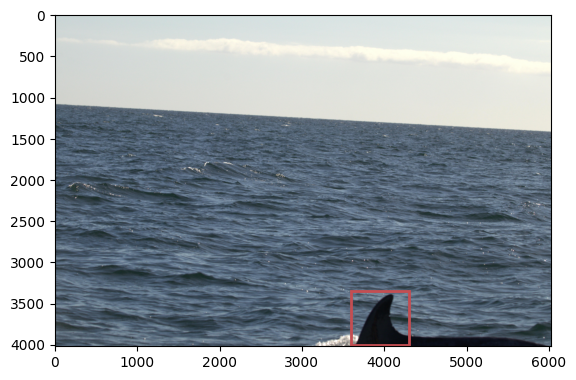


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/SB23-1975-506.JPG: 448x640 2 fins, 39.8ms
Speed: 1.6ms preprocess, 39.8ms inference, 0.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


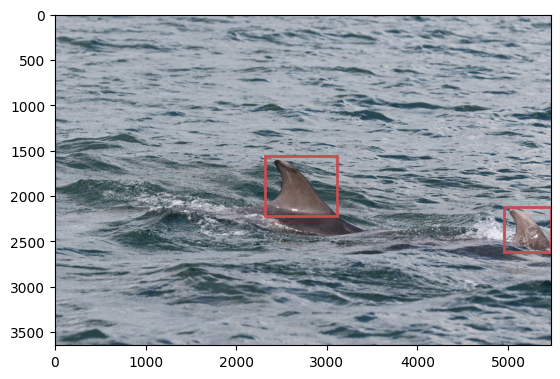


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/SB23-1972-195.JPG: 448x640 2 fins, 36.0ms
Speed: 1.4ms preprocess, 36.0ms inference, 0.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


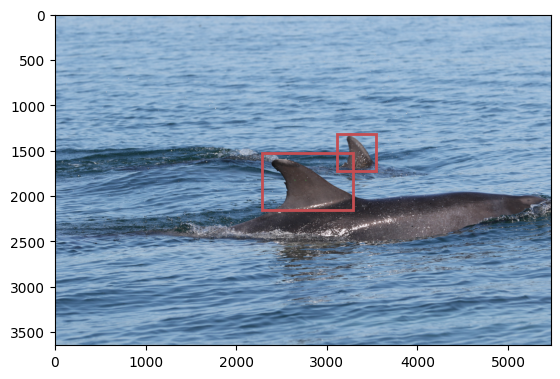


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/SB24-2056-019.JPG: 448x640 1 fin, 69.8ms
Speed: 1.3ms preprocess, 69.8ms inference, 0.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


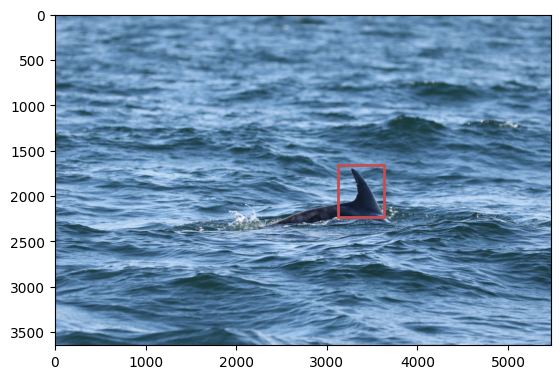


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/SB23-1972-196.JPG: 448x640 2 fins, 34.3ms
Speed: 1.7ms preprocess, 34.3ms inference, 0.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


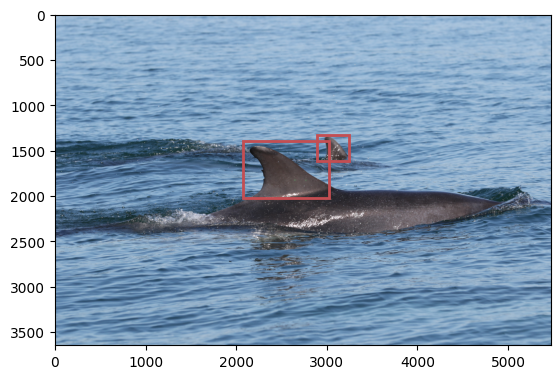


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/SB16-1619-121.JPG: 448x640 1 fin, 41.4ms
Speed: 1.5ms preprocess, 41.4ms inference, 0.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


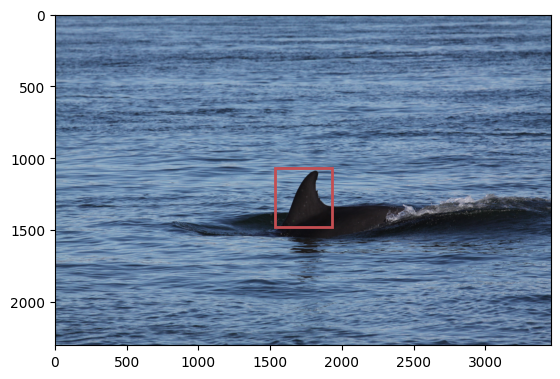


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/SB17-1650-098.JPG: 448x640 1 fin, 38.2ms
Speed: 1.6ms preprocess, 38.2ms inference, 0.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


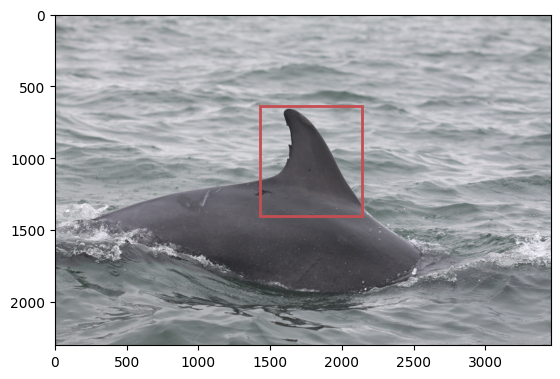


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/SB15-1591-826.JPG: 448x640 1 fin, 40.8ms
Speed: 1.4ms preprocess, 40.8ms inference, 0.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


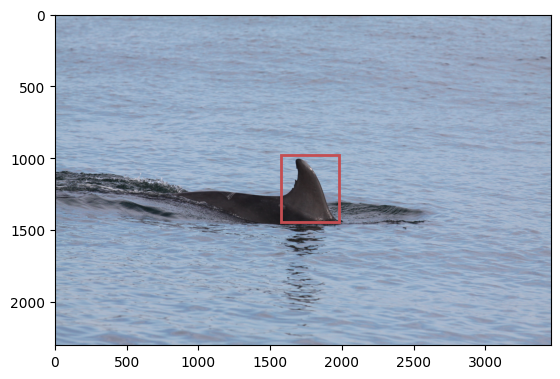


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/SB20-1807-542.JPG: 448x640 1 fin, 37.0ms
Speed: 1.4ms preprocess, 37.0ms inference, 0.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


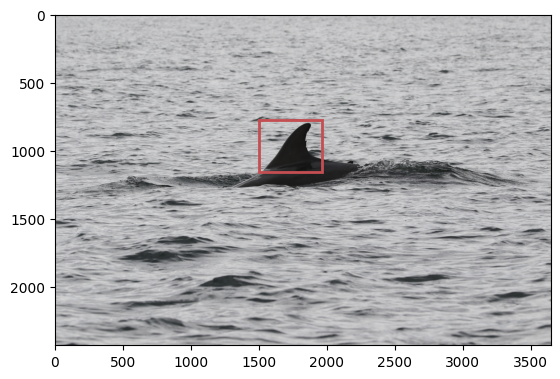


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/SB23-1975-515.JPG: 448x640 4 fins, 42.9ms
Speed: 1.5ms preprocess, 42.9ms inference, 0.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


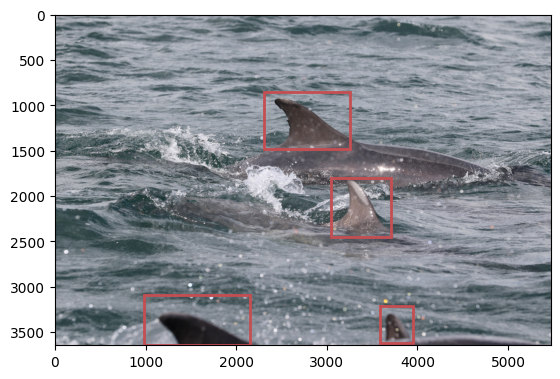


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/SB23-1985-454.JPG: 448x640 2 fins, 31.9ms
Speed: 1.3ms preprocess, 31.9ms inference, 0.7ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


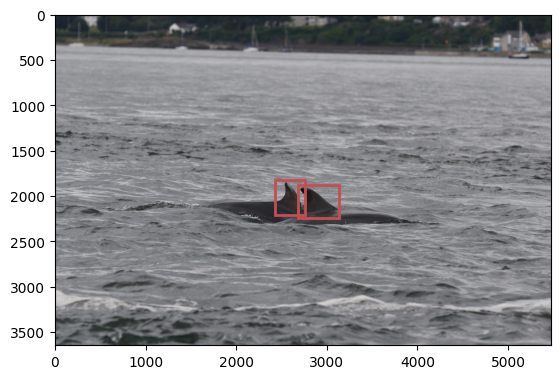


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/SB23-1998-703.JPG: 448x640 2 fins, 34.4ms
Speed: 1.4ms preprocess, 34.4ms inference, 0.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


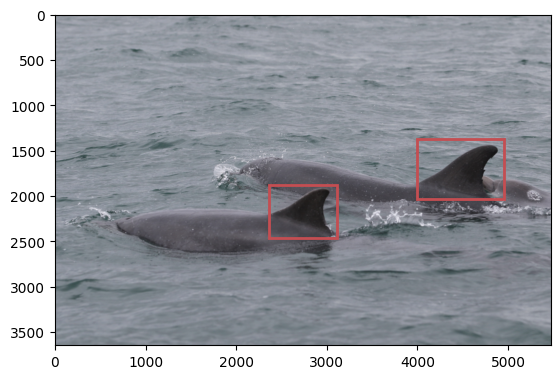


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/SB15-1591-825.JPG: 448x640 1 fin, 39.9ms
Speed: 1.5ms preprocess, 39.9ms inference, 0.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


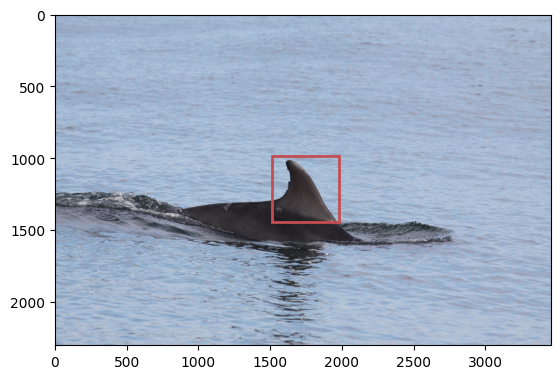


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/SB15-1591-818.JPG: 448x640 3 fins, 33.8ms
Speed: 1.5ms preprocess, 33.8ms inference, 0.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


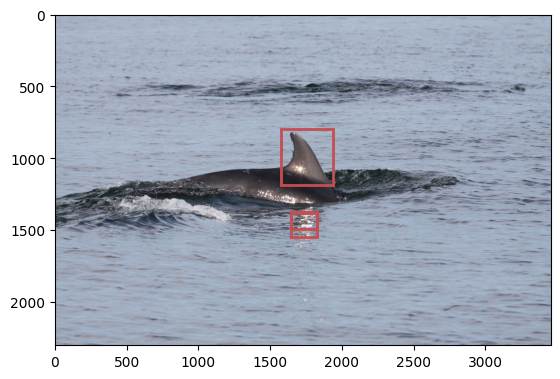


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/SB24-2056-020.JPG: 448x640 1 fin, 37.2ms
Speed: 1.4ms preprocess, 37.2ms inference, 0.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


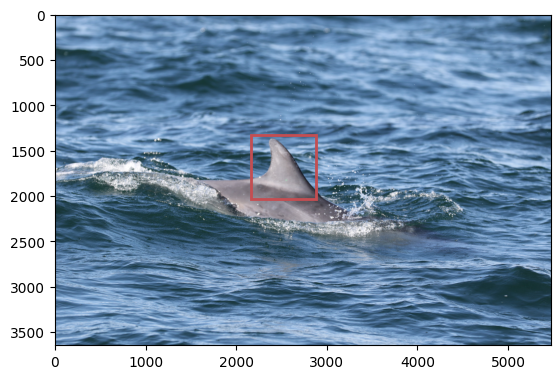


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/SB24-2056-090.JPG: 448x640 1 fin, 34.5ms
Speed: 1.4ms preprocess, 34.5ms inference, 0.4ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


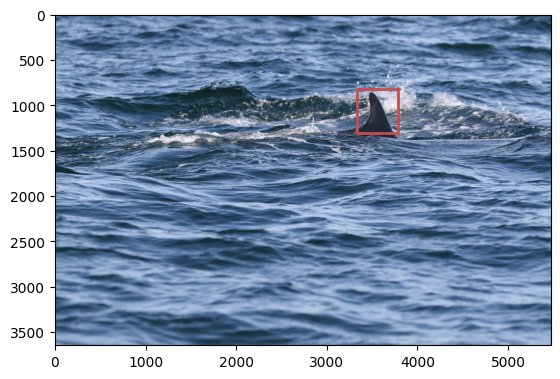


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/SB15-1572-382.JPG: 448x640 1 fin, 32.9ms
Speed: 1.5ms preprocess, 32.9ms inference, 0.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


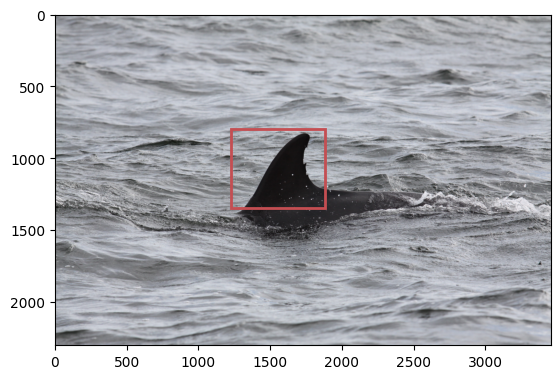


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/SB24-2056-085.JPG: 448x640 2 fins, 34.7ms
Speed: 1.4ms preprocess, 34.7ms inference, 0.5ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


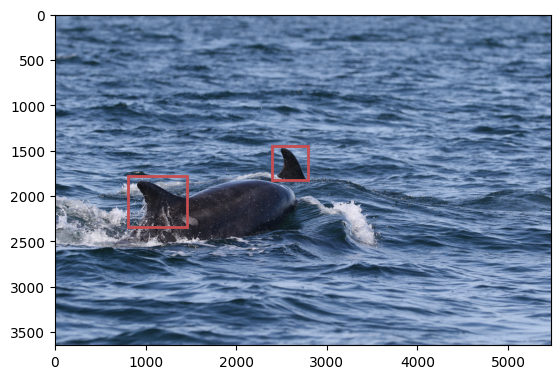


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/SB24-2056-091.JPG: 448x640 1 fin, 32.0ms
Speed: 1.4ms preprocess, 32.0ms inference, 0.5ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


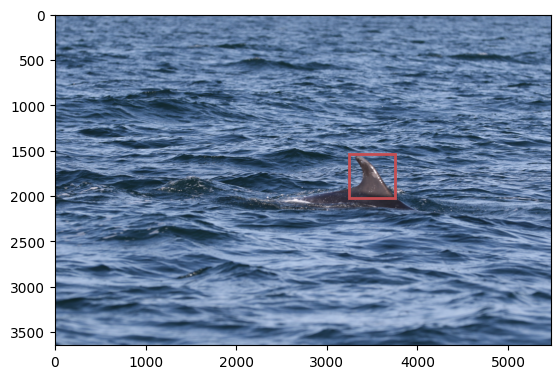


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/SB23-1979-230.JPG: 448x640 3 fins, 34.0ms
Speed: 1.5ms preprocess, 34.0ms inference, 0.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


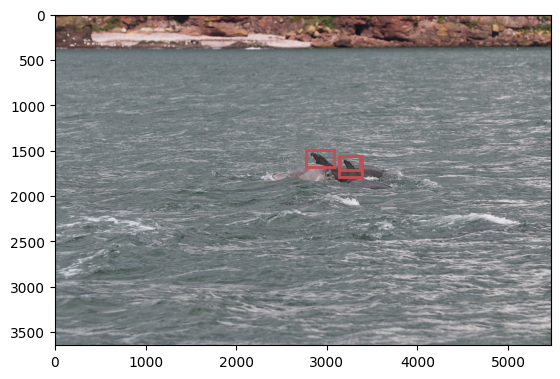


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/SB24-2056-087.JPG: 448x640 1 fin, 36.0ms
Speed: 1.7ms preprocess, 36.0ms inference, 0.5ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


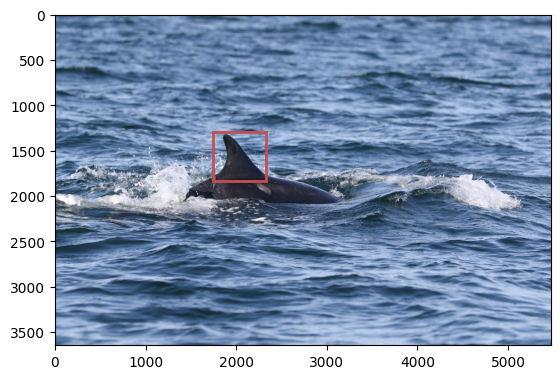


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/SB24-2056-093.JPG: 448x640 1 fin, 41.3ms
Speed: 1.4ms preprocess, 41.3ms inference, 0.5ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


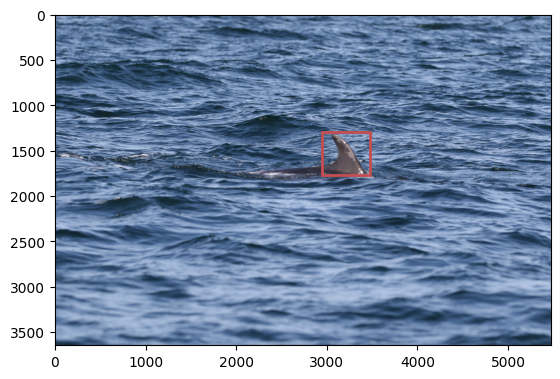


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/SB21-1863-374.JPG: 448x640 1 fin, 39.5ms
Speed: 1.9ms preprocess, 39.5ms inference, 1.1ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


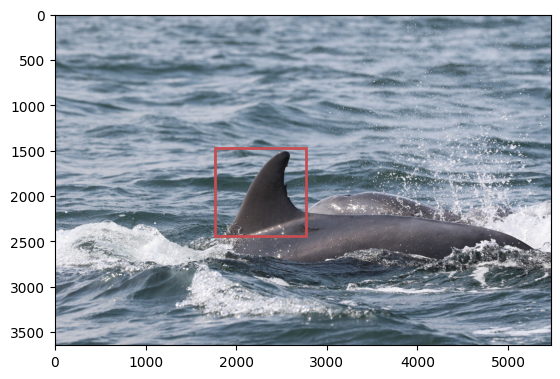


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/SB23-1979-141.JPG: 448x640 1 fin, 37.2ms
Speed: 1.5ms preprocess, 37.2ms inference, 0.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


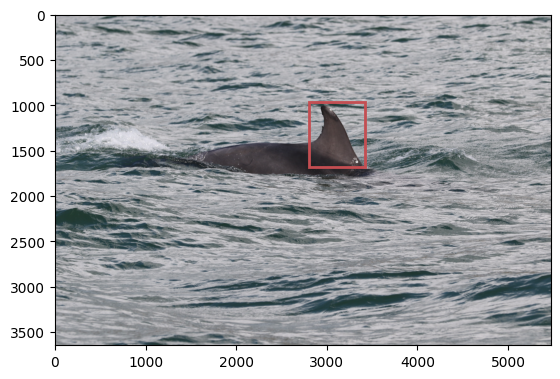


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/SB24-2056-069.JPG: 448x640 3 fins, 38.0ms
Speed: 1.5ms preprocess, 38.0ms inference, 0.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


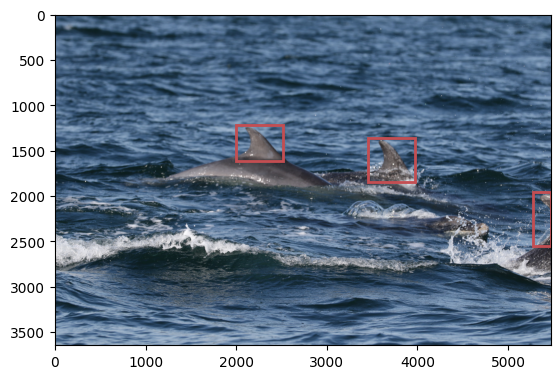


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/SB16-1619-153.JPG: 448x640 1 fin, 36.0ms
Speed: 1.6ms preprocess, 36.0ms inference, 0.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


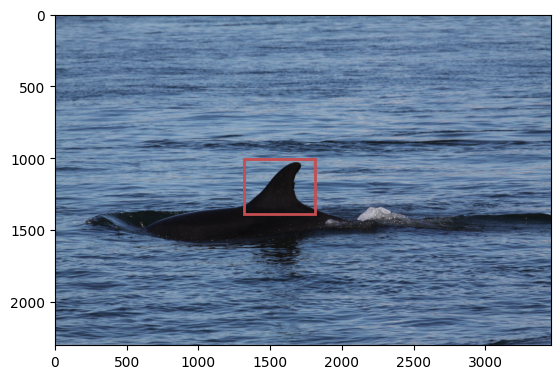


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/SB24-2056-068.JPG: 448x640 4 fins, 36.4ms
Speed: 1.4ms preprocess, 36.4ms inference, 0.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


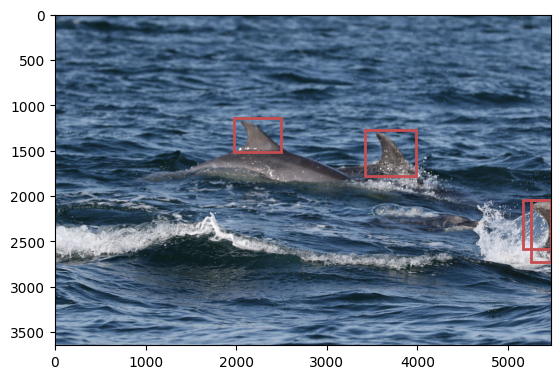


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/SB24-2056-083.JPG: 448x640 2 fins, 39.1ms
Speed: 1.5ms preprocess, 39.1ms inference, 0.4ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


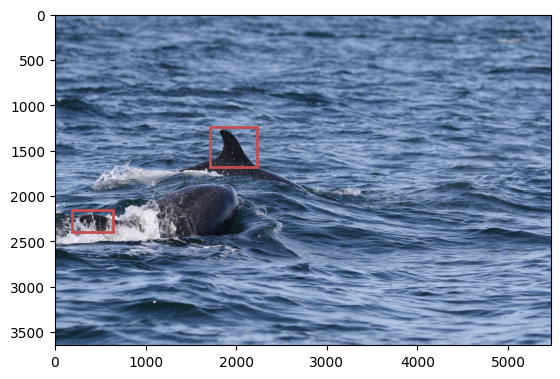


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/SB19-1758-194.JPG: 448x640 1 fin, 38.0ms
Speed: 1.4ms preprocess, 38.0ms inference, 0.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


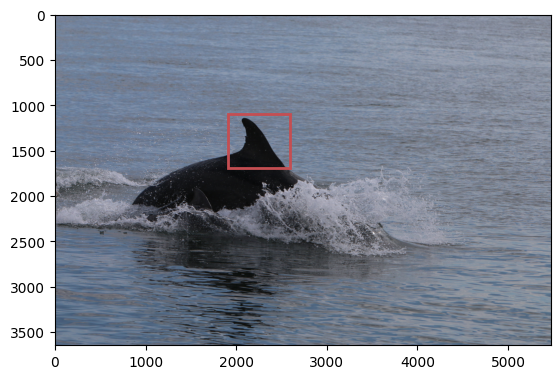


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/SB20-1807-721.JPG: 448x640 1 fin, 35.6ms
Speed: 1.5ms preprocess, 35.6ms inference, 0.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


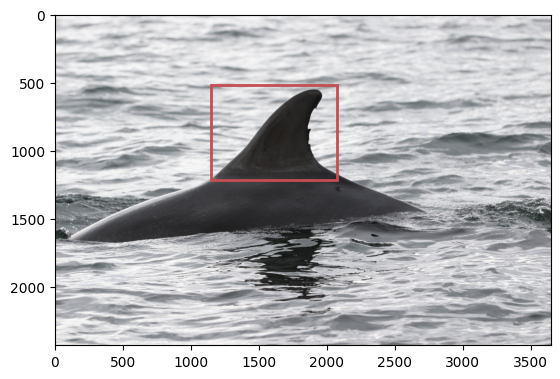


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/SB18-1706-331.JPG: 448x640 1 fin, 33.8ms
Speed: 1.5ms preprocess, 33.8ms inference, 0.4ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


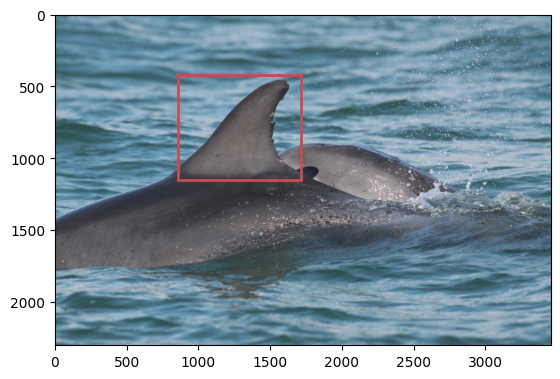


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/0J4A2899.JPG: 448x640 1 fin, 36.5ms
Speed: 1.4ms preprocess, 36.5ms inference, 0.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


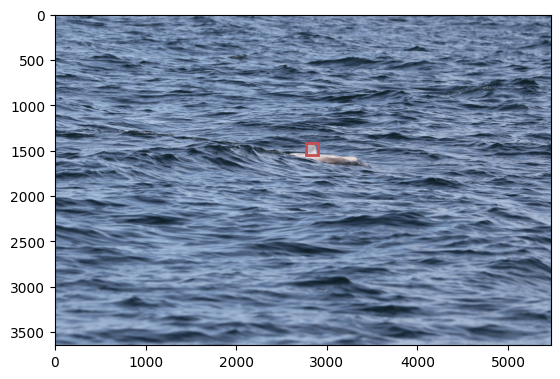


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/SB24-2056-057.JPG: 448x640 2 fins, 34.0ms
Speed: 1.5ms preprocess, 34.0ms inference, 0.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


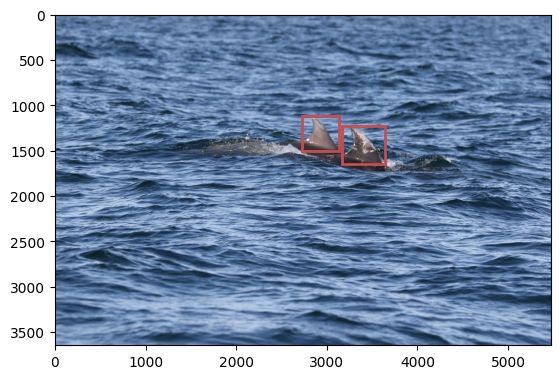


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/SB24-2056-094.JPG: 448x640 2 fins, 33.2ms
Speed: 1.4ms preprocess, 33.2ms inference, 0.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


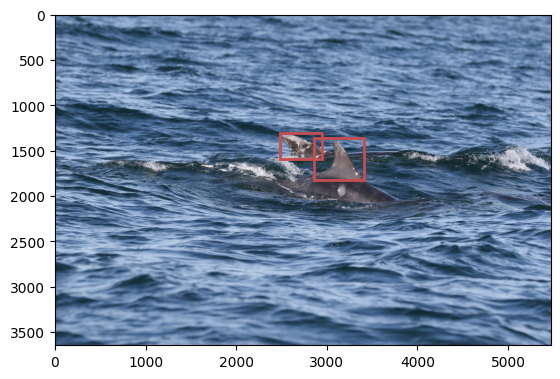


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/IMG_4956.JPG: 448x640 1 fin, 33.5ms
Speed: 1.5ms preprocess, 33.5ms inference, 0.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


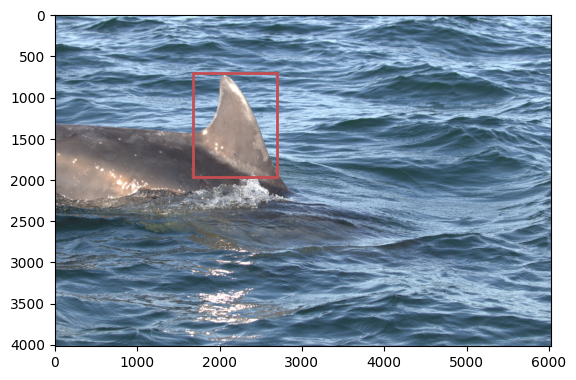


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/SB24-2056-099.JPG: 448x640 2 fins, 46.8ms
Speed: 1.4ms preprocess, 46.8ms inference, 0.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


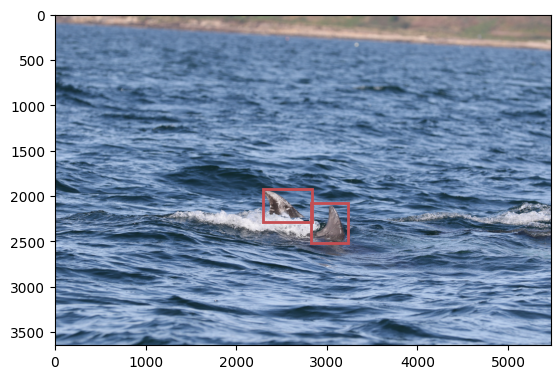


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/SB23-1998-751.JPG: 448x640 2 fins, 37.5ms
Speed: 1.4ms preprocess, 37.5ms inference, 0.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


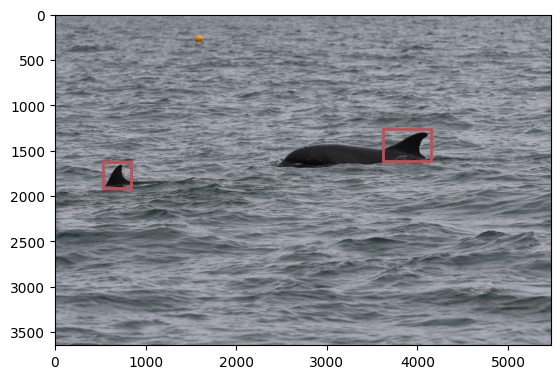


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/SB24-2056-048.JPG: 448x640 2 fins, 44.7ms
Speed: 1.6ms preprocess, 44.7ms inference, 0.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


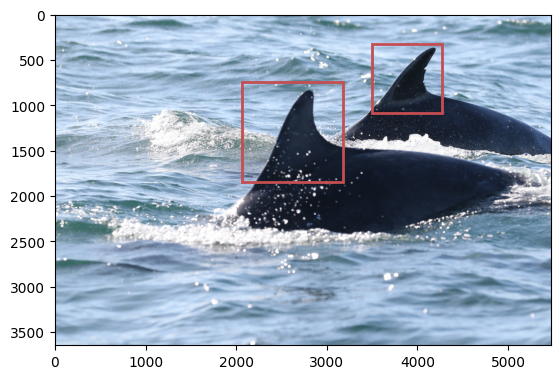


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/SB24-2056-061.JPG: 448x640 2 fins, 34.4ms
Speed: 1.4ms preprocess, 34.4ms inference, 0.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


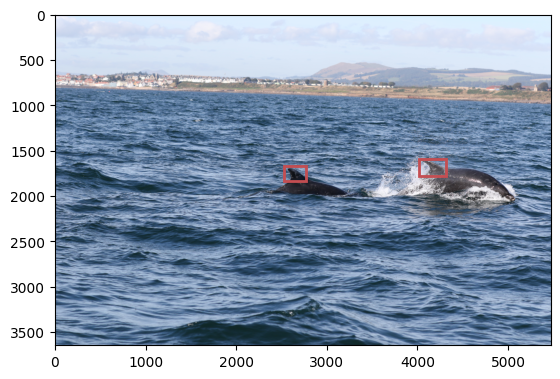


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/SB24-2056-049.JPG: 448x640 2 fins, 42.9ms
Speed: 1.7ms preprocess, 42.9ms inference, 0.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


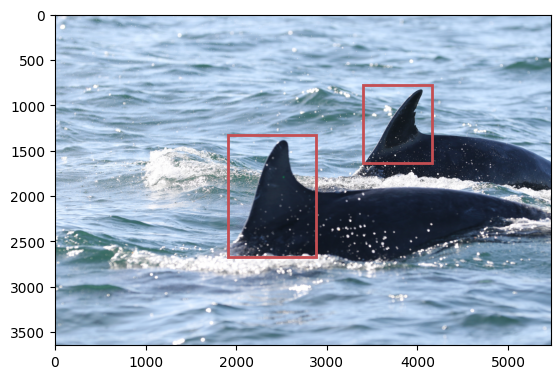


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/SB23-1975-437.JPG: 448x640 4 fins, 37.1ms
Speed: 1.4ms preprocess, 37.1ms inference, 0.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


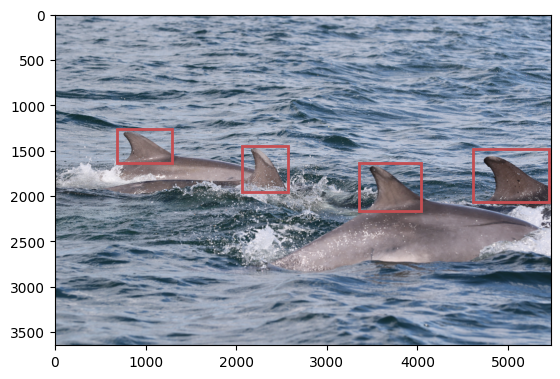


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/IMG_4974.JPG: 448x640 1 fin, 32.4ms
Speed: 1.7ms preprocess, 32.4ms inference, 0.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


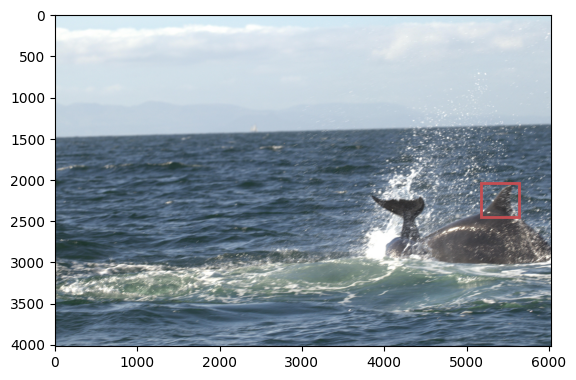


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/0J4A2104.JPG: 448x640 1 fin, 77.1ms
Speed: 1.4ms preprocess, 77.1ms inference, 0.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


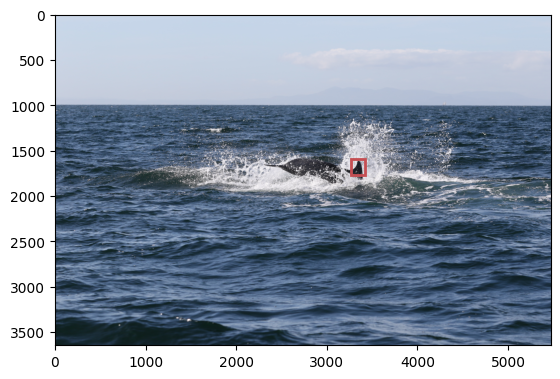


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/IMG_4962.JPG: 448x640 2 fins, 36.6ms
Speed: 1.5ms preprocess, 36.6ms inference, 0.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


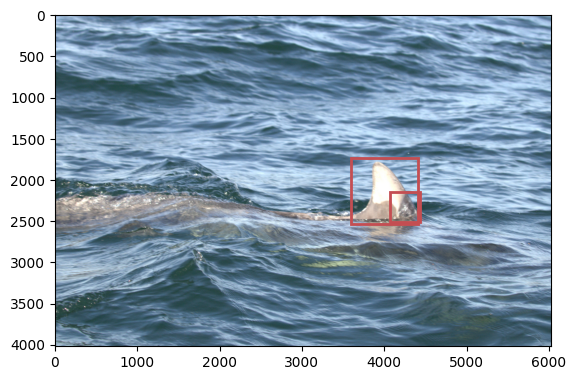


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/SB21-1873-420.JPG: 448x640 1 fin, 36.3ms
Speed: 1.4ms preprocess, 36.3ms inference, 0.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


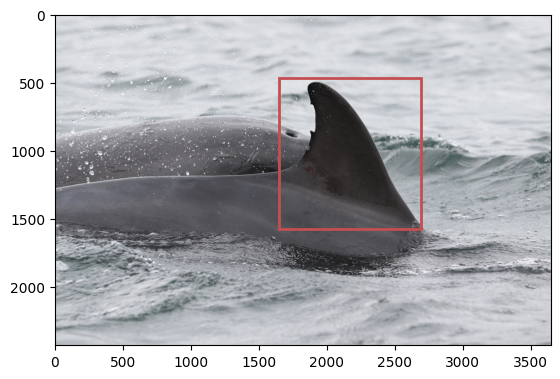


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/SB24-2056-062.JPG: 448x640 2 fins, 39.8ms
Speed: 2.2ms preprocess, 39.8ms inference, 0.4ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


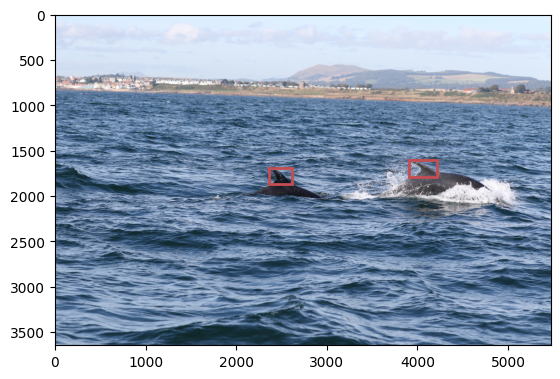


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/SB23-1998-797.JPG: 448x640 1 fin, 36.6ms
Speed: 1.7ms preprocess, 36.6ms inference, 0.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


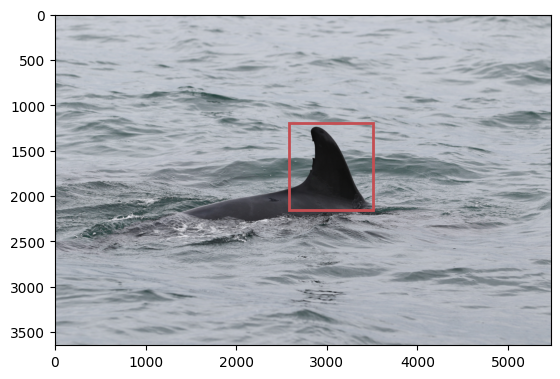


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/SB17-1650-130.JPG: 448x640 1 fin, 40.7ms
Speed: 4.3ms preprocess, 40.7ms inference, 0.2ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


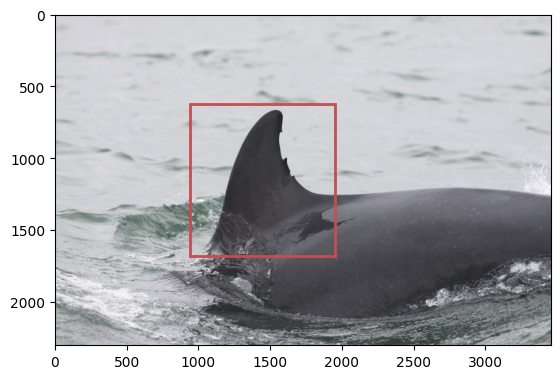


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/SB23-1972-177.JPG: 448x640 1 fin, 35.7ms
Speed: 1.4ms preprocess, 35.7ms inference, 0.5ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


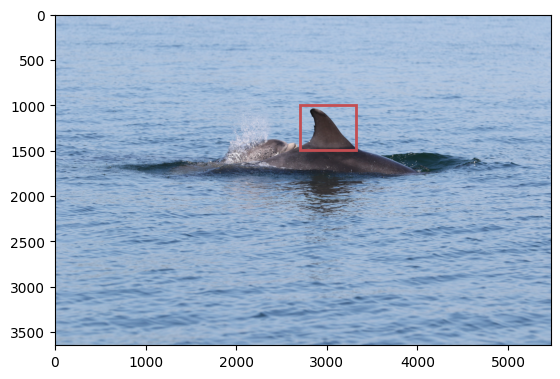


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/SB24-2056-039.JPG: 448x640 1 fin, 35.8ms
Speed: 1.4ms preprocess, 35.8ms inference, 0.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


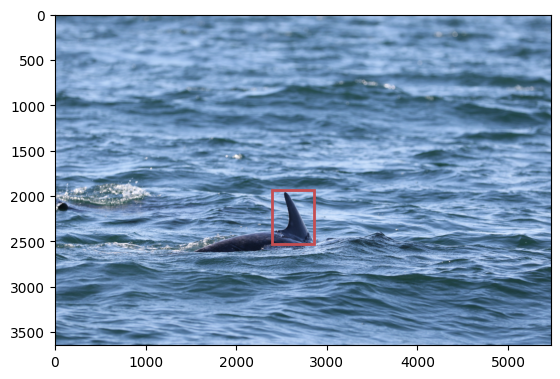


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/SB24-2056-038.JPG: 448x640 1 fin, 38.0ms
Speed: 1.4ms preprocess, 38.0ms inference, 0.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


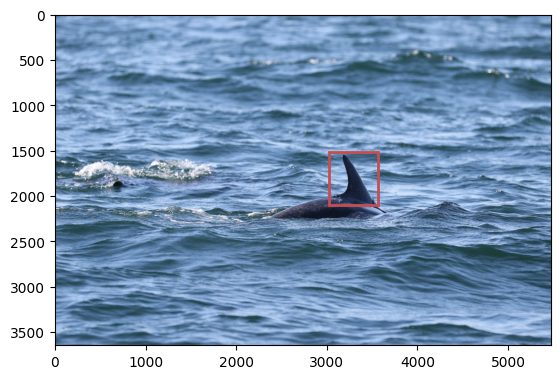


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/SB23-1975-254.JPG: 448x640 1 fin, 35.8ms
Speed: 1.5ms preprocess, 35.8ms inference, 0.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


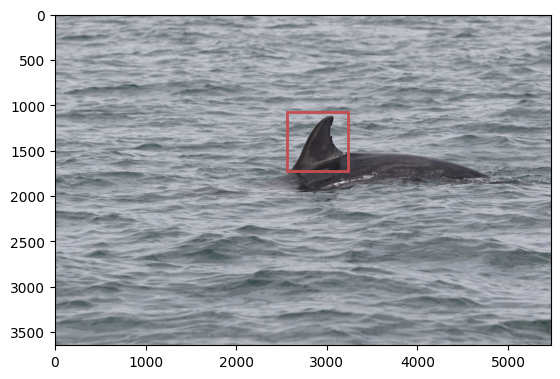


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/IMG_4906.JPG: 448x640 1 fin, 55.3ms
Speed: 1.7ms preprocess, 55.3ms inference, 0.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


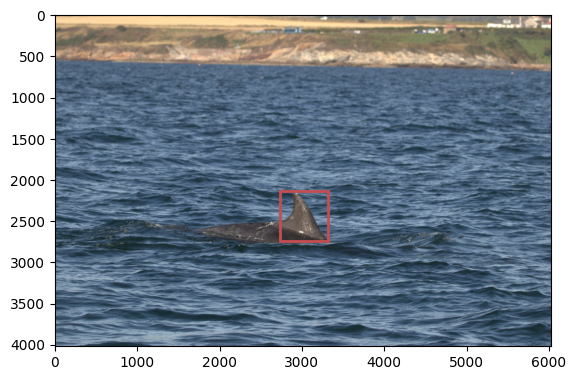


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/SB23-1972-207.JPG: 448x640 1 fin, 40.0ms
Speed: 2.4ms preprocess, 40.0ms inference, 0.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


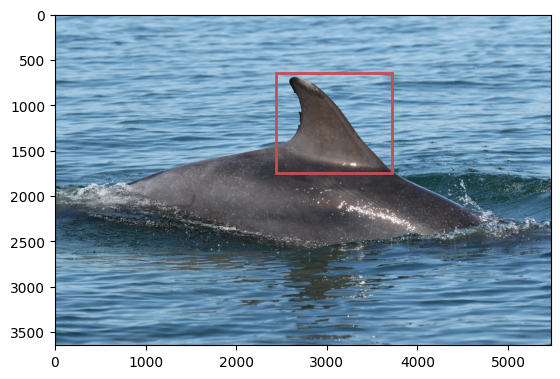


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/SB20-1807-824.JPG: 448x640 1 fin, 39.5ms
Speed: 1.7ms preprocess, 39.5ms inference, 0.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


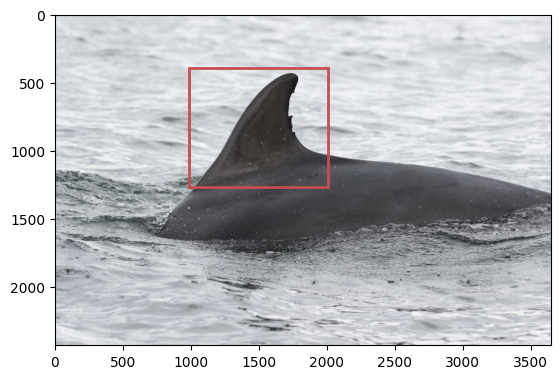


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/SB24-2056-015.JPG: 448x640 1 fin, 37.1ms
Speed: 1.4ms preprocess, 37.1ms inference, 0.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


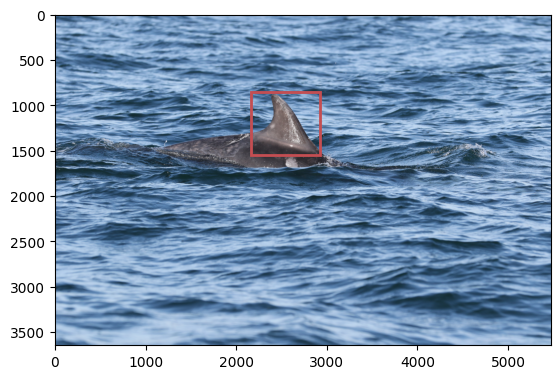


image 1/1 /Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images/SB17-1650-097.JPG: 448x640 1 fin, 52.0ms
Speed: 1.9ms preprocess, 52.0ms inference, 0.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict7


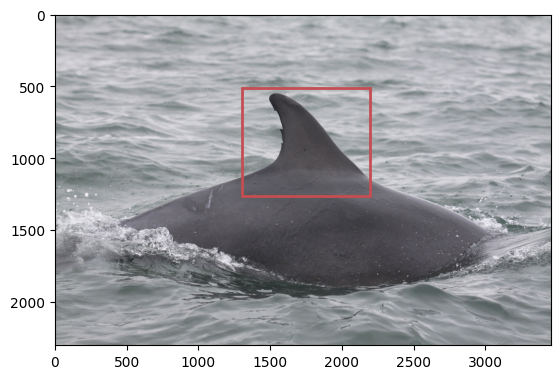

In [25]:
model = YOLO("/Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/best.pt") 
val_image_dir = '/Users/dimonster/Desktop/homework/ML/ML-Bottlenose-Dolphins/yolo/val/images'

for image_file in os.listdir(val_image_dir):
    if image_file.endswith('.JPG'):
        # Load the image
        image_path = os.path.join(val_image_dir, image_file)
        image = Image.open(image_path).convert('RGB')
        
        results = model.predict(image_path, save=True)
        
        # Plot the image
        plt.imshow(image)

        # Visualize the results
        for result in results:
            bboxes = result.boxes.xyxy.numpy()
            for bbox in bboxes:
                x_min, y_min, x_max, y_max = bbox
                rect = plt.Rectangle((x_min, y_min), x_max - x_min, y_max - y_min, edgecolor='r', linewidth=2, fill=False)
                plt.gca().add_patch(rect)

        
        # Show the plot
        plt.show()
